# Helmholtz simulation

This notebook takes you through a very basic simulation of the Helmholtz equation.  I hope it's helpful to your understanding of how quite a simple differential equation can give rise to a lot of different phenomena.  

It can be run and edited using [Google Colab](https://colab.research.google.com/github/rwb27/PH30077/blob/master/Wavetank.ipynb).

The first cell just imports the libraries we need, so you can ignore it unless you are particularly keen to learn about animations embedded in iPython!

In [24]:
import matplotlib.pyplot as plt
import numpy as np
import time

# This next bit sets things up for animation.
import matplotlib
import matplotlib.animation
from contextlib import contextmanager
# Set the default animation method to be JavaScript + HTML, which we can easily 
# embed in a notebook.
plt.rcParams["animation.html"] = "jshtml"
# Set the default plot backend to be "inline", i.e. plot to a PNG and display
# it below the cell.
%matplotlib inline
%matplotlib inline

# If we're using the "inline" backend, then when we make animations, we will
# render two graphs, one animated and one static.  This context manager allows
# us to suppress the static one.
@contextmanager
def hide_matplotlib_figures():
    """Temporarily stop graphs being displayed.
    
    If we animate graphs using matplotlib.animate, it
    is desirable to not show the graph directly.  If 
    we are using "inline" graphs, this happens automatically.
    This block of code temporarily disables inline graphs, so
    we can set up an animation, and then display it later.
    
    Example:
    ```
    with hide_matplotlib_figures():
      fig, ax = plt.subplots(1,1)

    # Insert animation code here (it doesn't need to be indented)
    matplotlib.animation.FuncAnimation(...)
    ```
    """
    backend_ =  matplotlib.get_backend() 
    matplotlib.use("Agg", warn=False)  # Prevent showing stuff
    matplotlib.use("Agg", warn=False)  # (sometimes needed twice!)
    try:
        yield
    finally:
        matplotlib.use(backend_, warn=False)  # Restore original setting

# Simulating the Helmholtz equation
The wave equation is one of the fundamentals of physics, arising from many different physical systems with a pleasing universality.  In electromagnetism waves propagating in free space obey the Helmholtz equation:
$$\left(\nabla^2 + {1\over c^{2}}\partial_t^2\right)\psi = 0$$
In lectures we'll work through this analytically, but it's actually fairly simple, and quite fun, to solve it numerically.  The code below is neither optimally fast nor incredibly accurate, but it should exhibit enough of the important physical phenomena that it's both fun and informative to play with.

The simulation will work in discrete steps in both space and time: we perform the trivial rearrangement to state that:

$${1\over c^{2}}\partial_t^2\psi(t) = \nabla^2 \psi(t)$$

This means that the way the wavefunction changes over time can be specified by its current spatial derivatives.  It's probably easiest to understand by discretising time.

## Discrete steps for time
In order to perform a very simple simulation, we must discretise the problem in both time and space.  If we start by discretising time in steps of $\Delta_t$, we can write each time step as $\psi_i \equiv \psi(i\Delta_t)$.  That leads to a very simple approximation of:
$$\left(\partial_t\psi\right)_{i-{1\over2}} \approx {\psi_i-\psi_{i-1} \over \Delta_t}$$
i.e. we approximate the first derivative as the difference between adjacent points, divided by the time step. Similarly,

\begin{eqnarray}
\left(\partial_t^2\psi\right)_{i} & \approx & 
{\left(\partial_t\psi\right)_{i+{1\over2}}-
\left(\partial_t\psi\right)_{i-{1\over2}} 
\over \Delta_t}
\end{eqnarray}
\begin{eqnarray}
 & = & { \psi_{i+1} + \psi_{i-1} - 2\psi_i \over 2 \Delta_t}
\end{eqnarray}

This can be rearranged to give $\psi_{i+1}$ as a function of the previous two time steps and the second derivative:
$$\psi_{i+1} = 2\psi_i - \psi_{i+1} + 2\Delta_t\left(\partial_t^2\psi\right)_{i}$$
We can then substitute the value for the second derivative in from the Helmholtz equation to get:
$$\psi_{i+1} = 2\psi_i - \psi_{i+1} + 2\Delta_tc^2\nabla^2\psi_{i}$$
This means that we can calculate the next wavefunction as a function of the current and previous ones, provided we can calculate the Laplacian.  The following cell performs one step of this simulation (note that it relies on a function `laplacian()` that we'll write in a moment).  The value of the argument `B` is something we'll come back to.

In [31]:
def iterate_wave(wave, wave_prev, B):
    """Perform one iteration of a wave equation
    
    wave is the current value of the wavefunction
    wave_prev is the previous value of the wavefunction
    
    The parameter B sets the value of c^2 * delta_t/delta_x
    """
    wave_next = wave*2 - wave_prev + B * laplacian3D(wave)
    return wave_next

## Discrete steps in space
Discretising the laplacian can be done in a similar manner to the second derivative in time.  Here, I am using indices $j$ and $k$ to represent two spatial dimensions, i.e. $\psi_{j, k} \equiv \psi(j\Delta_x, k\Delta_x)$.  Note that I'm assuming $\Delta_x=\Delta_y$, because non-uniform scaling will make things more complicated.  Skipping the first spatial derivative, we can give an expression for the second spatial derivative:
$$
\left(\partial_x^2\psi\right)_{j,k} \approx { \psi_{j+1, k} + \psi_{j-1, k} - 2\psi_{j, k} \over 2 \Delta_x}
$$
Combinging $x$ and $y$,
$$
\left(\nabla^2\psi\right)_{j,k}
 = \left(\partial_x^2\psi\right)_{j,k} + \left(\partial_y^2\psi\right)_{j,k}
 \approx { \psi_{j+1, k} + \psi_{j-1, k} + \psi_{j, k+1} + \psi_{j, k-1} - 4\psi_{j, k} \over 2 \Delta_x}
$$
This can be efficiently implemented as a convolution, with a kernel that is ${1 / 2 \Delta_x}$ above, below, and to each side of a pixel, and ${-2 / \Delta_x}$ in the centre.  The `laplacian()` function in the next cell implements this numerically.

In [26]:
def laplacian3D(wave):
    """Calculate the discrete laplacian of a wave
    
    This approximates the second spatial derivative as defined above, and
    ignores the spatial step size - so the return value is actually the 
    Laplacian multiplied by the step size.
    """
    res = -3*wave
    res[1:, :, :] += wave[:-1, :, :]/2
    res[:-1, :, :] += wave[1:, :, :]/2
    res[:, 1:, :] += wave[:, :-1, :]/2
    res[:, :-1, :] += wave[:, 1:, :]/2
    res[:, :, 1:] += wave[:, :, :-1]/2
    res[:, :, :-1] += wave[:, :, 1:]/2
    # Strange things happen at the edges! for now, we'll just make them zero.
    res[0, :, :] = 0
    res[-1, :, :] = 0
    res[:, 0, :] = 0
    res[:, -1, :] = 0
    res[:, :, 0] = 0
    res[:, :, -1] = 0
    return res

From the previous cell, we needed a constant `B` in our simulation.  Because the `laplacian()` function isn't aware of the step size, it is effectively defined such that:
$$ \mathtt{laplacian}(\psi_i) = \Delta_x\nabla^2\psi_{i}.$$
That means that the simulation should be evaluating:
$$\psi_{i+1} = 2\psi_i - \psi_{i+1} + {2c^2 \Delta_t \over \Delta_x}\nabla^2\psi_{i}$$
and consequently that the parameter `B` can be defined as:
$$\mathtt{B} \equiv {2c^2 \Delta_t \over \Delta_x}$$
It is convenient to set $\Delta_t = \Delta_x = 1$ and thus $\mathtt{B} = 2c^2$.  In order for the simulation to be stable, we want the speed of light to be rather less than one pixel per time-step, so generally I'll set $\mathtt{B}\lessapprox 0.5$.

In order to visualise the simulation, we need some plotting code - there's no need to look at this too closely.  The code in the next cell will take a stack of frames, and display them in an image plot, in sequence.

In [27]:
def animate_stack(stack, vmax=None):
    """Display a stack of frames as an animation"""
    if vmax is None:
      vmax = np.max(stack)
    n_frames = stack.shape[0]
    with hide_matplotlib_figures():
      fig, ax = plt.subplots(1, 1, figsize=(8,6))
    image = ax.imshow(stack[0, ...], vmin=-vmax, vmax=vmax, cmap="PiYG")

    def animate(i):
      """Display the ith frame"""
      image.set_data(stack[i, ...])
      return (image, )

    return matplotlib.animation.FuncAnimation(fig, animate, n_frames, blit=True)

# Pebble in a pond
Now we run our first, very simple, simulation.  We'll excite a wave with a single transient at the centre of the array, and allow it to evolve from there.  This is analogous to dropping a pebble in a pond.

In [32]:
# Start by making an array of zeros to represent no waves in space
wave = np.zeros((128, 128, 128), dtype=float)
wave_prev = np.zeros_like(wave)

# This is a very simple perturbation - we excite 
# the central point with a delta function.  You can move it by 
# changing the indices below.
wave[64,64,64] = 100

# Now we simulate, by calculating each frame based on the previous two.
# We hold on to all the frames in a "stack" to animate them later.
n_frames = 100
stack = np.zeros((n_frames,) + wave.shape, dtype=wave.dtype)
stack[0, ...] = wave_prev
stack[1, ...] = wave
for i in range(2, n_frames):
    stack[i, ...] = iterate_wave(stack[i-1, ...], stack[i-2, ...], 0.3)

animate_stack(stack[:,:,stack.shape[2]//2,...], vmax=1)

As well as an animation, sometimes it can be helpful to plot a slice through the stack of simulation frames - here, we take a slice through the middle, and plot the evolving wave against X and time.

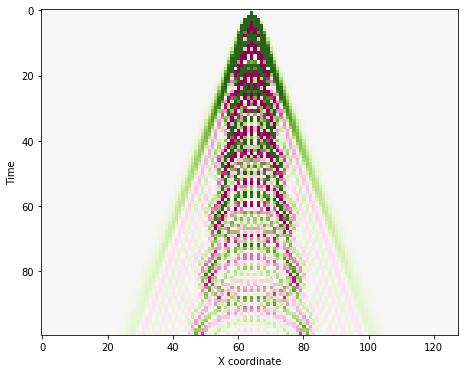

In [33]:
fig, ax = plt.subplots(1,1, figsize=(8,6))
ax.imshow(stack[:,64,64,:], cmap="PiYG", vmax=1, vmin=-1)
ax.set_xlabel("X coordinate")
ax.set_ylabel("Time")

None # Suppress the display of the "Time" label object

We have just implemented a very basic wave equation simulator!  Our approach is simple but effective, and we can explore a lot of phenomena with it.  Have a play.  Things you should try are:
* Vary $B$ to explore the effect of changing the speed of the wave.  Is there a maximum that makes sense?
* Move the point source around - what happens when the wave hits an edge? Can you guess why?
* Can you make a line source instead - what does that do to the wave?
* What is the frequency of this wave?

# Radiation at a single frequency
The last question is a bit of a trick: it's a delta function perturbation, so it doesn't have a defined frequency.  If we want a wave with a defined frequency, we need to excite in a slightly more sophisticated way.  We also need to initialise the value of both `wave` and `wave_prev`, because otherwise we'd have a transient at the start of the simulation.

The cell below implements a very simple implementation of a single-frequency source, by adding an oscillating term to particular pixels in the simulation.  This is equivalent to adding a non-zero term to the right hand side of our differential equation, just like
$$\left(\nabla^2 + {1\over c^{2}}\partial_t^2\right)\phi = -\frac{\rho}{\epsilon_0}$$
which then gives:
$$\phi_{i+1} = 2\phi_i - \phi_{i+1} + 2\Delta_tc^2\nabla^2\psi_{i} + \frac{\rho_i}{\epsilon_0}$$


In [36]:
def add_sources(wave, sources, phase):
    """Add sources in to a wavefunction
    """
    return wave + np.real(sources * np.exp(1j * phase))

# Start by making an array of zeros to represent no waves in space
wave = np.zeros((128, 128, 128), dtype=float)
sources = np.zeros_like(wave, dtype=complex)
angular_frequency = 0.5 # wave frequency, in radians-per-step

# This is a very simple perturbation - we excite the central point 
# with a delta function, which we'll now make oscillate in time.
sources[64,64,64] = 1

# We must initialise the first frame to avoid a discontinuity
# at the start of the simulation.  The second frame's sources 
# are added in by the first iteration of the simulation.
n_frames = 100
stack = np.zeros((n_frames,) + wave.shape, dtype=wave.dtype)
stack[0, ...] = add_sources(stack[0, ...], sources, 0)

# Now we run the simulation as before, with an extra step to add
# the source term.
for i in range(2, n_frames):
    # First, we add the sources in to the wavefunction
    stack[i-1, ...] = add_sources(stack[i-1, ...], sources, i*angular_frequency)
    # Then, we propagate it in time
    stack[i, ...] = iterate_wave(stack[i-1, ...], stack[i-2, ...], 0.5)

animate_stack(stack[:,:,64,], vmax=1)

We can tidy away most of the simulation code into a couple of functions, which are defined below.

In [41]:
# This cell defines a couple of "boilerplate" functions to save some typing

def make_arrays(size=(128, 128, 128), n_frames=100):
    """Make the `stack` and `sources` arrays"""
    stack = np.zeros((n_frames,) + size, dtype=float)
    sources = np.zeros_like(stack[0], dtype=complex)
    return stack, sources

def simulate(
        stack, 
        sources, 
        B=0.5, 
        angular_frequency=0.5, 
        add_sources_t0=True
    ):
    """Run a simulation.  Results are saved in `stack`."""
    if add_sources_t0:
        # Initialise the first frame with the source term
        stack[0, ...] = add_sources(stack[0, ...], sources, 0)
    for i in range(2, stack.shape[0]):
        # First, we add the sources in to the wavefunction
        stack[i-1, ...] = add_sources(stack[i-1, ...], sources, i*angular_frequency)
        # Then, we propagate it in time
        stack[i, ...] = iterate_wave(stack[i-1, ...], stack[i-2, ...], 0.5)
    return stack

def simulate_and_animate(stack, *args, **kwargs):
    simulate(stack, *args, **kwargs)
    return animate_stack(stack[:,:,64,...], vmax=1)


# Playtime!
Now that we have a simulation with a source in it, we can do lots of fun things:
* Add two sources, so they interfere like Young's slits.
* Make one of the two sources negative, and see how it changes the interference pattern.
* Make a line source, and see how it changes the radiation pattern.
* Can you make a source pattern that focuses the wave?

In [42]:


scalar_potential, charge = make_arrays(n_frames=100)

# Below are a few options 
charge[64,63,64] = -1
charge[64,64,64] = 1

simulate_and_animate(scalar_potential, charge, B=0.5, angular_frequency=0.5)

In [44]:
Az, Jz = make_arrays(n_frames=100)
Jz[64,64,63] = 1
Jz[64,64,64] = 1
Az = simulate(Az, Jz, B=0.5, angular_frequency=0.5)
Ax = np.zeros_like(Az)
Ay = Ax
vector_potential = np.stack([Ax, Ay, Az], axis=2)

def diff_and_crop(A, axis=-1, ndim=None):
    """Take a derivative, cropping other axes"""
    ndim = len(A.shape) if ndim is None else ndim
    starts = [slice(None,-1), ] * ndim
    stops = [slice(None,-1), ] * ndim
    stops[axis] = slice(1,)
    return A[..., tuple(stops)] - A[..., tuple(starts)]
    

# Take the curl of vector_potential
def curl(field):
    out = []
    for i in range(3):
        derivative = diff_and_crop(field[:,:,:,(i+2)%3], axis=(i+1)%3, ndim=3)
        derivative -= diff_and_crop(field[:,:,:,(i+1)%3], axis=(i+2)%3, ndim=3)
        out.append(derivative)
    return np.stack(out, axis=4)

E = curl(vector_potential)

MemoryError: Unable to allocate 4.69 GiB for an array with shape (100, 128, 3, 128, 128) and data type float64

In [19]:
# This is a crude approximation to a Hertz dipole

stack, sources = make_arrays(n_frames=150)
sources[63,64] = 1   # one half of the dipole
sources[64,64] = -1  # the other half, note opposite sign

simulate_and_animate(stack, sources, B=0.5, angular_frequency=0.5)

## Finding the electric field
The cell above simulates a dipole, oriented vertically.  However, it's simulating the *scalar potential* rather than the electric field.  If we really want to get the electric field, we need to first calculate the current, then the vector potential, then combine it all together to get the fields.  We can use the same 1D simulation for the current, as it's only got one cartesian component:

In [23]:
Az_stack, Jz_sources = make_arrays(n_frames=150)
Jz_sources[63,64] = 1   # one half of the dipole
Jz_sources[64,64] = 1  # the other half

simulate_and_animate(Az_stack, Jz_sources, B=0.5, angular_frequency=0.5)

We can find the magnetic field by taking the curl of $\mathbf{A}$ and the electric field by taking the curl of that.  Trouble is, curl doesn't really work on a 2D field!

In [22]:
def grad2d(stack):
    """Take the spatial gradient of a 2D field
    
    We add an extra dimension at the end, as this is a
    scalar -> vector operation.
    Input data can have arbitrarily many dimensions.
    However, we will only differentiate the last 2 
    dimensions.
    
    Each differentiated dimension will be reduced in size
    by one element.
    """
    gx = np.diff(stack, axis=-2)
    gy = np.diff(stack, axis=-1)
    return np.stack([gx[...,:,:-1], gy[...,:-1,:]], axis=len(stack.shape))

E = grad2d(stack)
magE = E[...,0]**2 + E[...,1]**2
animate_stack(E[...,0], vmax=E[...,0].max()*0.1)